# Homework 3: Generative Adversarial Networks
---
Here, you will study one of the most popular approaches to generative modeling. We will consider a toy problem and a simplified model since state-of-the-art generative models take weeks to converge on multiple GPUs. This will make the final results not that impressive, but still instructive.

For this assignment, it is advised to use a **GPU** accelerator.

In [1]:
# Uncomment and run if in Colab
!mkdir datasets
!gdown --id 1LPYTu85QYYe_d1IS0l0v3fKzG3gjXrwC -O datasets/flowers-17.tar.gz
!tar -xzf datasets/flowers-17.tar.gz -C datasets
!rm datasets/flowers-17.tar.gz
!gdown --id 1kpL8fGK2AkgCJmMcWklIuP8A8B8xCAC2
!tar -xzf part2_gans.tar.gz
!rm part2_gans.tar.gz

!pip install pytorch_lightning
!pip install scipy

mkdir: cannot create directory ‘datasets’: File exists
/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1LPYTu85QYYe_d1IS0l0v3fKzG3gjXrwC
To: /content/datasets/flowers-17.tar.gz
100% 1.71M/1.71M [00:00<00:00, 119MB/s]
/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1kpL8fGK2AkgCJmMcWklIuP8A8B8xCAC2
To: /content/part2_gans.tar.gz
100% 410k/410k [00:00<00:00, 103MB/s]


In [2]:
# Determine the locations of auxiliary libraries and datasets.
# `AUX_DATA_ROOT` is where 'tiny-imagenet-2022.zip' is.

# Detect if we are in Google Colaboratory
try:
    import google.colab
    IN_COLAB = True
except ImportError:
    IN_COLAB = False

from pathlib import Path
if IN_COLAB:
    google.colab.drive.mount("/content/drive")
    
    # Change this if you created the shortcut in a different location
    AUX_DATA_ROOT = Path("/content/drive/MyDrive/DL_hw3/")
    
    assert AUX_DATA_ROOT.is_dir(), "Have you forgot to 'Add a shortcut to Drive'?"
    
    import sys
    sys.path.append(str(AUX_DATA_ROOT))
else:
    AUX_DATA_ROOT = Path(".")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Datasets

We will use a pre-processed [17 category Flowers dataset](https://www.robots.ox.ac.uk/~vgg/data/flowers/17/). Below are few samples of the original images. We will use a processed version: images that are center square cropped and resized to 64 pixels.

<img src="https://i.imgur.com/OYQd8JY.jpg"/>

## Assignments and grading


- **Part 1. Code**: fill in the empty gaps (marked with `#TODO`) in the code of the assignment (36 points):
    - `model.py` -- 26 points
    - `loss.py` -- 8 points
    - `train.py` -- 2 points
- **Part 2. Train and benchmark** the performance of the required models (7 points):
    - All 3 checkpoints are provided -- 3 points
    - All 4 variants are evaluated -- 4 points
- **Part 3. Report** your findings (9 points)
    - Each task -- 3 points

- **Total score**: 50 points.

The grading policy is the same as in the semantic segmentation task. It is provided below:

For detailed grading of each coding assignment, please refer to the comments inside the files. Please use the materials provided during a seminar and during a lecture to do a coding part, as this will help you to further familiarize yourself with PyTorch. Copy-pasting the code from Google Search will get penalized.

In part 2 of this task, you should upload all your pre-trained checkpoints to your personal Google Drive, grant public access and provide a file ID, following the intructions in the notebook.

Note that for each task in part 3 to count towards your final grade, you should complete the corresponding tasks in part 2.

For example, if you are asked to compare Model X and Model Y, you should provide the checkpoints for these models in your submission trained for the required number of epochs.

## Part 1. Code

### `model.py`
**TODO: implement generator and discriminator models.**

We will use DCGAN architecture as a base, but with a few key modifications which significantly improve the quality of the results.

<img src="https://i.imgur.com/h4ubSt9.png"/>

#### 1. Each block is a pre-activation residual block.

<img src="https://i.imgur.com/CqQM9mO.jpg"/>

It has a much better gradient flow compared to the standard residual block and is now fairly common in generative models. If needed, upsampling is performed at the start of the block (before branching), and downsampling is performed at the end (after residual sum).

#### 2. We conditon on the noise vector multiple times throughout the network.

One of the most popular ways of doing that is via adaptive batch normalization:

$$
    x = \frac{ x - \mu }{ \sigma } \gamma + \beta,\quad \gamma = f(z),\ \beta = g(z)
$$

The first part of this operation is a standard batch normalization, but instead of optimizing $\gamma$ and $\beta$ as a vector, we optimize functions $f$ and $g$, which predict affine parameters from a noise vector $z$. Typically these functions are simple linear mappings.

#### 3. We condition both generation and discrimination on classes.

If our data is labeled with classes, we can use these to boost the performance of our GANs. The conditioning of the generator is straightforward: we simply train embeddings for each available class, and concatenate them with noise to use as inputs to the network and its adaptive batch normalization layers:

<img src="https://i.imgur.com/VFiaU6N.jpg"/>

Therefore, our model produces its outputs using not only the noise vector $z$ but also on a class $k$, for each of which we train an embedding vector $c_k$.

For the discriminator, one of the most popular ways of conditioning on a class label is by using the so-called "projection":

<img src="https://i.imgur.com/jCwkb5R.png"/>

In this scheme, $\phi$ denotes a convolutional part of the discriminator, which outputs a vector; $\psi$ is a linear layer with maps a vector into a single digit; $y$ is a trainable class embedding. The output of this projection layer is fed into an adversarial loss. This layer allows the discriminator to learn whether or not a synthesized image belongs to the class which we input into the generator.

To sum up, generator class embeddings $c$ and discriminator embeddings $y$ are vectors from trainable matrices of the shape $\text{number of classes} \times \text{dimensionality of the embeddings}$, corresponding to the class $k$ which we condition our sample on. In our case, these matrices will be different for generator and discriminator and will have different embedding dimensionalities.

### `loss.py`
**TODO: implement train and validation losses.**

#### Training

There are multiple ways to train generative adversarial networks. We will try out 3 of them, which historically preceded each other.

#### 1. Non-saturating GAN

$$
    \mathcal{L}_D = - \mathbb{E}_{x\sim p_\text{real}} [ \log D(x) ] - \mathbb{E}_{z\sim \mathcal{N}(0, \mathbb{I})} [ \log(1 - D(G(z)) ]
$$

$$
    \mathcal{L}_G = - \mathbb{E}_{z\sim \mathcal{N}(0, \mathbb{I})} [\log D(G(z))]
$$

It corresponds to using a standard binary cross-entropy loss for $D$, and BCE with fake data treated as real data for $G$.

#### 2. Hinge Loss GAN

$$
    \mathcal{L}_D = -\mathbb{E}_{x\sim p_\text{real}} \big[ \min\big(0, -1 + D(x) \big) \big] - \mathbb{E}_{z\sim \mathcal{N}(0, \mathbb{I})} \big[ \min\big(0, -1 - D(G(z)) \big) \big]
$$

$$
    \mathcal{L}_G = - \mathbb{E}_{z\sim \mathcal{N}(0, \mathbb{I})} D(G(z))
$$

This objective is derived from a hinge loss (used, for example, as an objective in SVMs). Arguably, it has the best gradient flow, and now it a go-to objective for GAN training.

#### Validation

For validation, we will use two main metrics: **Frechet Inception Distance (FID)** and **Inception Score (IS)**.

They are both calculated using the outputs of an **Inception v3** network (hence "inception" in their names), although any other pre-trained classification network can also be used in the same way to obtain similar metrics.

#### 1. Frechet Inception Distance

This metric is calculated using a feature vector right after global average pooling before the final classification head. The feature vector can be treated as a multi-dimensional random variable with some distribution. This distribution will be different, if we evaluate these features using real images from the dataset, or images generated using our generative models. The general idea behind **FID** is to try and approximate the difference between these two distributions and use it as a quality metric (the lower it is, the better).

To do that, we approximate these two distribution using a multivariate gaussian distribution. To do that, we need to calculate the mean vector $\mu$ and a covariance matrix $\Sigma$ using either samples from the dataset: $\mu_r$, $\Sigma_r$, or generated samples: $\mu_g$, $\Sigma_g$. Note that these are full covariance matrices.

Then, **FID** can be calculated using KL divergence between these two distributions:

$$
    \text{FID} = ||\mu_r - \mu_g||^2 + \text{tr}\,\big(\Sigma_r + \Sigma_g - 2(\Sigma_r \Sigma_g)^{1/2}\big)
$$

#### 2. Inception Score

For this metric, we will need the outputs of the classification head, which we should convert to class probabilities via a softmax. 

To calculate it, we will only use generated data, and try to evaluate two qualities: their "objectiveness", and the diversity.

For the "objectiveness" metric, we can look at the distribution of the class probabilities and check whether or not it has a pike. Here, we assume that outputs of our generative models should represent objects, which have a structure, similar to an ImageNet dataset. This would be a bad assumption if we generate X-ray or other medical images, but it's actually fairly true for natural images, thanks to the diversity of ImageNet. If our model generates a smeared blob of artifacts, it is unlikely to be classified as some object by an ImageNet classifier.

A good measure to determine if the distribution is "piky" is entropy. It is the lowest if predicted probability is a one-hot vector, and highest if it is uniform accross all calsses.

For "diversity", we are going to use the same idea: our samples are diverse, if their averaged class probability distribution is uniform.

Combining these two measurements, we can come up with the following objective:

$$
    \text{IS} = \exp \Bigg[ \mathbb{E}_{\hat{x}\sim p(\hat{x})}\ \text{KL} \big( p(y \mid \hat{x})\ \big\|\ p(y) \big) \Bigg] = \exp \Bigg[ \mathbb{E}_{\hat{x}\sim p(\hat{x})} \sum_{k=1}^{K}\ p(y_k \mid \hat{x}) \log \bigg[ \frac{ p(y_k \mid \hat{x} ) }{ p(y_k) } \bigg] \Bigg]
$$

where $K = 1000$ for ImageNet-pretrained networks.

For more details about derivation and applicability, you can refer to this [link](https://medium.com/octavian-ai/a-simple-explanation-of-the-inception-score-372dff6a8c7a).

### `train.py`

Here you will need to write a training step for GANs (alternating gradients descend, where we first update the generator, and thenn a discriminator), and also implement a neat feature called "truncation trick".

There are multiple ways to improve test-time performance of trained GANs (i.e., obtain better samples). Some are more complicated, like [usage of Langevin dynamics](https://arxiv.org/abs/2003.06060) for sampling, some are much simpler, like [rejection sampling](https://arxiv.org/abs/1810.06758). We will consider the simplest, yet one of the most effective and universally used approaches: [truncation trick](https://paperswithcode.com/method/truncation-trick).

The idea is based on an observation that if, instead of $\mathcal{N}(0, \mathbb{I})$, we sample from a truncated normal distribution, the results that we get will have a better visual quality. You will have to implement sampling from a truncated normal distribution and use it during evaluation.

## Part 2. Train and evaluate

You will have to train and evaluate the following variants for the generative model:

1. Non-class conditional setting: non-saturating GAN and hinge Loss GAN
2. Class conditional hinge loss GAN
3. Evaluate class conditional hinge loss GAN with truncation trick

For training, use the code example below, with the provided number of epochs. For evaluation use `GANValLoss` class that you have implemented. You need to obtain **FID** and **IS** values for all the 4 required experiments.

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
# import shutil
# shutil.rmtree('/content/part2_gans')

In [5]:
import pytorch_lightning as pl
from part2_gans.train import GAN

def train(model, experiment_name, use_gpu):
    assignment_dir = 'part2_gans'

    logger = pl.loggers.TensorBoardLogger(save_dir=f'{assignment_dir}/logs', name=experiment_name)

    trainer = pl.Trainer(
        max_epochs=100, 
        gpus=1 if use_gpu else None, 
        benchmark=True, 
        logger=logger) 
    
    trainer.fit(model)

In [6]:
use_gpu = True

In [ ]:
# # my
# model = GAN(
#     loss_type='non_saturating',
#     class_conditional=True,
#     truncation_trick=False, 
#     data_path='datasets/flowers-17')

# train(model, 'non_saturating', use_gpu=use_gpu)

In [ ]:
model = GAN(
    loss_type='non_saturating',
    class_conditional=False,
    truncation_trick=False, 
    data_path='datasets/flowers-17')

train(model, 'non_saturating', use_gpu=use_gpu)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:131: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:308: LightningDeprecationWarning: The `LightningModule.on_epoch_end` hook was deprecated in v1.6 and will be removed in v1.8. Please use `LightningModule.on_<train/validation/test>_epoch_end` instead.
  f"The `LightningModule.{hook}` hook was deprecated in v1.6 and"
Missing logger folder: part2_gans/logs/non_saturating
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type          | Params
---------------------------------------
0 | gen  | Generator     | 4.

Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [ ]:
model = GAN(
    loss_type='hinge',
    class_conditional=False,
    truncation_trick=False, 
    data_path='datasets/flowers-17')

train(model, 'hinge', use_gpu=use_gpu)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:131: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:308: LightningDeprecationWarning: The `LightningModule.on_epoch_end` hook was deprecated in v1.6 and will be removed in v1.8. Please use `LightningModule.on_<train/validation/test>_epoch_end` instead.
  f"The `LightningModule.{hook}` hook was deprecated in v1.6 and"
Missing logger folder: part2_gans/logs/hinge
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type          | Params
---------------------------------------
0 | gen  | Generator     | 4.0 M 
1 | 

Training: 0it [00:00, ?it/s]

In [ ]:
model = GAN(
    loss_type='hinge',
    class_conditional=True,
    truncation_trick=False, 
    data_path='datasets/flowers-17')

train(model, 'hinge_class-cond', use_gpu=use_gpu)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:131: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:308: LightningDeprecationWarning: The `LightningModule.on_epoch_end` hook was deprecated in v1.6 and will be removed in v1.8. Please use `LightningModule.on_<train/validation/test>_epoch_end` instead.
  f"The `LightningModule.{hook}` hook was deprecated in v1.6 and"
Missing logger folder: part2_gans/logs/hinge_class-cond
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type          | Params
---------------------------------------
0 | gen  | Generator     | 

Training: 0it [00:00, ?it/s]

In [ ]:
model = GAN(
    loss_type='hinge',
    class_conditional=True,
    truncation_trick=True, 
    data_path='datasets/flowers-17')

train(model, 'hinge_class-cond_trunk-trick', use_gpu=use_gpu)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:131: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:308: LightningDeprecationWarning: The `LightningModule.on_epoch_end` hook was deprecated in v1.6 and will be removed in v1.8. Please use `LightningModule.on_<train/validation/test>_epoch_end` instead.
  f"The `LightningModule.{hook}` hook was deprecated in v1.6 and"
Missing logger folder: part2_gans/logs/hinge_class-cond_trunk-trick
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type          | Params
---------------------------------------
0 | gen  | Gene

Training: 0it [00:00, ?it/s]

In [ ]:
!zip -r logs.zip part2_gans/logs/

  adding: part2_gans/logs/ (stored 0%)
  adding: part2_gans/logs/hinge_class-cond_trunk-trick/ (stored 0%)
  adding: part2_gans/logs/hinge_class-cond_trunk-trick/version_0/ (stored 0%)
  adding: part2_gans/logs/hinge_class-cond_trunk-trick/version_0/checkpoints/ (stored 0%)
  adding: part2_gans/logs/hinge_class-cond_trunk-trick/version_0/checkpoints/epoch=99-step=4400.ckpt (deflated 8%)
  adding: part2_gans/logs/hinge_class-cond_trunk-trick/version_0/events.out.tfevents.1651243786.9e833596657c.72.3 (deflated 0%)
  adding: part2_gans/logs/hinge_class-cond_trunk-trick/version_0/hparams.yaml (stored 0%)
  adding: part2_gans/logs/non_saturating/ (stored 0%)
  adding: part2_gans/logs/non_saturating/version_0/ (stored 0%)
  adding: part2_gans/logs/non_saturating/version_0/checkpoints/ (stored 0%)
  adding: part2_gans/logs/non_saturating/version_0/checkpoints/epoch=99-step=4400.ckpt (deflated 8%)
  adding: part2_gans/logs/non_saturating/version_0/events.out.tfevents.1651238537.9e833596657c.72

In [ ]:
# Copy log folder to Google Drive
!cp logs.zip '{AUX_DATA_ROOT}/logs.zip'
!ls '{AUX_DATA_ROOT}'

hw3-GANs-Trifonov-Vladislav-attempt-1.ipynb  logs.zip  part2_gans_1


Again, images can be viewed via a TensorBoard:

In [ ]:
%load_ext tensorboard
%tensorboard --logdir part2_gans/logs

<IPython.core.display.Javascript object>

Your trained weights are available in the `part2_gans/{experiment_name}/logs/version_{n}` folder. Upload them to your personal Google Drive folder. Provide file ids and checksums below. Use `!md5sum <PATH>` to compute the checksums.

To make sure that provided ids are correct, try running `!gdown --id <ID>` command from this notebook.

In [11]:
checkpoint_ids = {
    'non_saturating': ('1BP9183mCAWsp5tyOg7e66WzAYhofP_tK', '3a63eae982c119d013fb4b077a826e68'), # TODO
    'hinge': ('1kX5La1fSk0G6to7GEYlZM3aHiWWrpz82', '1aa77d278999ea7eab69b92f49c28a15'), # TODO
    'hinge_class-cond': ('1oPqC_M4DDEducJeudtHYHIiEgg5SPktp', 'bc1b478cb1bae03ca3f20f828e948df4'), # TODO
    'hinge_class-cond_trunk-trick': ('1d7F7iPPbS8RdNqMHcbttuVDRUuc9isPL', '41fe5bb348693380b4901ff3d320f71b')
}

**FID** and **IS** can be calculated like this:

In [7]:
import torch
from torchvision import utils, transforms
import glob
import os

from part2_gans.loss import ValLoss



def load_checkpoint(model, experiment_name):
    # Updated to run checkpoints from my gdrive
    # path_to_checkpoint = glob.glob('/content/drive/MyDrive/DL_hw3/checkpoints/' + experiment_name + '/*.ckpt')[0]

    version = max([int(name.split('_')[-1]) for name in os.listdir(f'part2_gans/logs/{experiment_name}')])
    path_to_checkpoint = glob.glob(f'part2_gans/logs/{experiment_name}/version_{version}/checkpoints/*.ckpt')[0]
    model.load_state_dict(torch.load(path_to_checkpoint)['state_dict'], strict=False)

def calc_eval_metrics(model, device):
    dataloader = model.val_dataloader()
    
    if device == 'cuda':
        model = model.cuda()
    
    val_noise = model.val_noise

    noise_offset = 0
    
    with torch.no_grad():
        real_imgs = []
        fake_imgs = []

        for imgs, labels in dataloader:
            noise = val_noise[noise_offset : noise_offset + imgs.shape[0]]
            noise_offset += imgs.shape[0]

            if device == 'cuda':
                imgs = imgs.cuda()
                labels = labels.cuda()
                noise = noise.cuda()

            gen_imgs = model.forward(noise, labels)

            real_imgs.append(imgs)
            fake_imgs.append(gen_imgs)

        val_loss = ValLoss()

        if device == 'cuda':
            val_loss = val_loss.cuda()

        fid, inception_score = val_loss(real_imgs, fake_imgs)
    
    return fid, inception_score

def visualize_image_grid(model):
    noise = model.val_noise[:16 * model.num_classes]
    labels = torch.arange(model.num_classes).repeat_interleave(16, dim=0).to(noise.device)

    fake_imgs = model.forward(noise, labels)
    fake_imgs = fake_imgs.detach().cpu()

    grid = utils.make_grid(fake_imgs, nrow=16)
    
    return transforms.ToPILImage()(grid)

In [8]:
model = GAN(
    loss_type='non_saturating',
    class_conditional=False,
    truncation_trick=False, 
    data_path='datasets/flowers-17')
load_checkpoint(model, 'non_saturating')

fid, inception_score = calc_eval_metrics(model.eval().cuda(), 'cuda' if use_gpu else 'cpu')

print(f'FID: {fid:.2f}, IS: {inception_score:.2f}')

# visualize_image_grid(model)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


FID: 132.61, IS: 2.25


In [9]:
model = GAN(
    loss_type='hinge',
    class_conditional=False,
    truncation_trick=False, 
    data_path='datasets/flowers-17')
load_checkpoint(model, 'hinge')

fid, inception_score = calc_eval_metrics(model.eval().cuda(), 'cuda' if use_gpu else 'cpu')

print(f'FID: {fid:.2f}, IS: {inception_score:.2f}')

# visualize_image_grid(model)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


FID: 131.45, IS: 2.48


In [10]:
model = GAN(
    loss_type='hinge',
    class_conditional=True,
    truncation_trick=False, 
    data_path='datasets/flowers-17')
load_checkpoint(model, 'hinge_class-cond')

fid, inception_score = calc_eval_metrics(model.eval().cuda(), 'cuda' if use_gpu else 'cpu')

print(f'FID: {fid:.2f}, IS: {inception_score:.2f}')

# visualize_image_grid(model)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


FID: 101.29, IS: 2.99


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


FID: 97.33, IS: 2.72


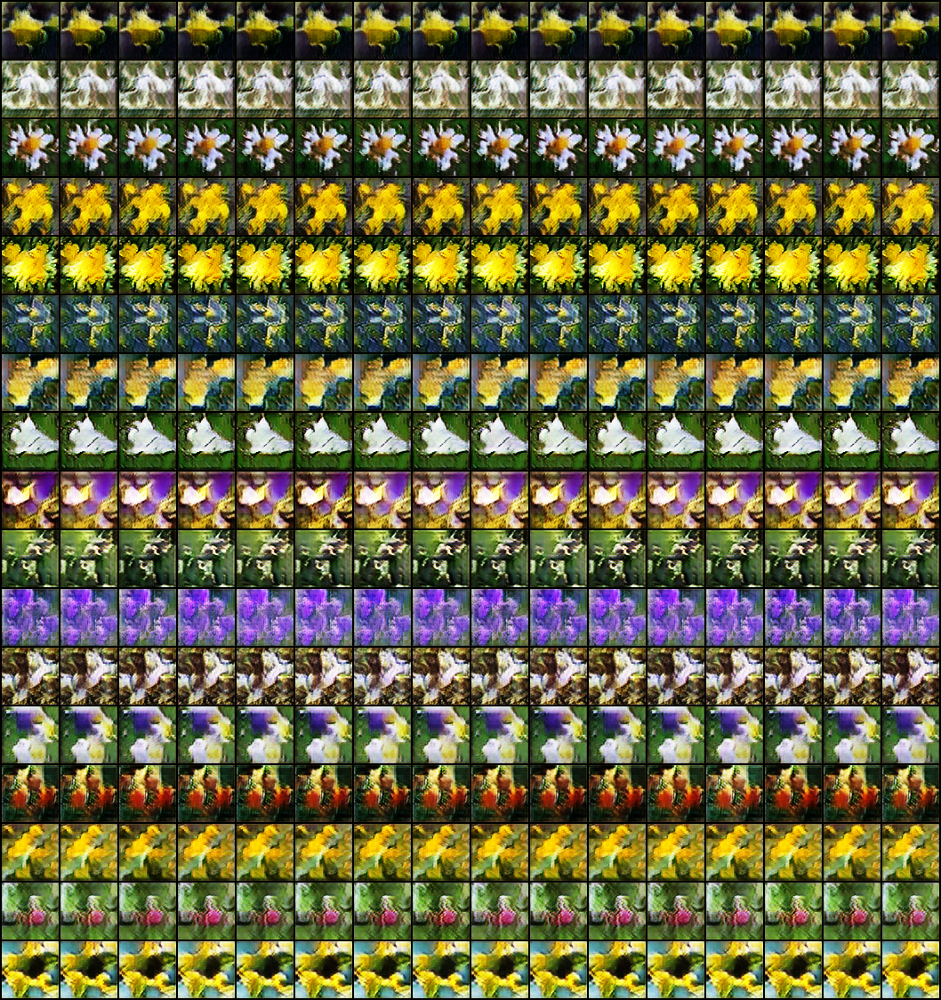

In [11]:
model = GAN(
    loss_type='hinge',
    class_conditional=True,
    truncation_trick=True, 
    data_path='datasets/flowers-17')
load_checkpoint(model, 'hinge_class-cond_trunk-trick')

fid, inception_score = calc_eval_metrics(model.eval().cuda(), 'cuda' if use_gpu else 'cpu')

print(f'FID: {fid:.2f}, IS: {inception_score:.2f}')

visualize_image_grid(model)

## Part 3. Report

In this part, you will need to analyze and compare the quality and performance of the trained models. Like semantic segmentation homework.

### Task 1.

Compare the performance of two evaluated GAN losses both qualitatively (comparing generated images side-by-side) and quantitatively (via metrics). What objective leads to the best results?

| ![image](https://drive.google.com/uc?export=view&id=1XoFdkZQy6vU6Wabn7j4VS-vCAcVkZicd) |![image](https://drive.google.com/uc?export=view&id=17RCP8wGICNHnRfuykjERMZpvVt2gIPAE) | 
|:--:|:--:| 
| **Loss Discriminator.** Orange — non_saturating; blue — hinge. | **Loss Generator.** Orange — non_saturating; blue — hinge. |

As far as I know, GANs' losses are really not stable, and we were supposed to train only 100 epoch. Actually, I see no reasnobale difference in plots for different types of losses.

---
| ![image](https://drive.google.com/uc?export=view&id=1Gbg7bAqgDtkNvQkMPZrKaNYUsJvzblU6), ![image](https://drive.google.com/uc?export=view&id=13MsfYoriclNpq_5V8JywnMix9KMawQbo), ![image](https://drive.google.com/uc?export=view&id=1uNMavjMoT540-j9uuZJf_9oFySzw0qop) |
|:--:|
| **GAN with non saturating loss.** |

|![image](https://drive.google.com/uc?export=view&id=1WQYUqi2OSbLtl_FKcssJ4jJPb7gcfoFb), ![image](https://drive.google.com/uc?export=view&id=1_ZwTjnHKX20c43t-6AYpO3jXY2RquT--), ![image](https://drive.google.com/uc?export=view&id=1lTV3KLZ-gZbX6hMcNIt65VgWydT4lgMf), ![image](https://drive.google.com/uc?export=view&id=1M6dc2f9ZafOAb9zT2R_q3iBC1FWaAcN9), ![image](https://drive.google.com/uc?export=view&id=1Re7eqEcUP3gMzQ7pR2dr8dDMcrI5nBKB) | 
|:--:|
| **GAN with hinge loss.** |

NS GAN (non saturating GAN) provieds some results which one can see above that looks something alike flowers. I beieve, this results are the best, others are less smooth and looks more like painted canvas.

Hinge GAN also generated pictures, that from my side looks even more like true flowers. Examples with pictures which are close to be a flower are more frequent for hinge GAN then for NS GAN.

---
| ![image](https://drive.google.com/uc?export=view&id=1AKHSsHN9f4JeISj5oLLhSJRZdkan0d8x), ![image](https://drive.google.com/uc?export=view&id=1--ZMWnwE8CKCqeCLbeBLh8WVvjCJg9Ag), ![image](https://drive.google.com/uc?export=view&id=1yQa6tQ_pZqm7C6yJUE_IWnVSEavsoKBz) |
|:--:|
| **GAN with non saturating loss.** |

|![image](https://drive.google.com/uc?export=view&id=1e3lQPo6Cx_xr7BxKGEAVonVSNRW570uR), ![image](https://drive.google.com/uc?export=view&id=1gGrPFRdgqeS6NwuKO6KyKoqTG4aWEzCO), ![image](https://drive.google.com/uc?export=view&id=1teAvWygTkX3_Q8nMsxjj4CR9DEEaGjJE), ![image](https://drive.google.com/uc?export=view&id=1Pteo3L4WQ1HOOL4ShrwbIwmMeT35OM0G), ![image](https://drive.google.com/uc?export=view&id=1mKZVp9KdZt_GleWOv26hTSABgVxYzf6Z), ![image](https://drive.google.com/uc?export=view&id=1EbkVJP3ixR1yXiTy52WVtEB5HEv2rKFG) | 
|:--:|
| **GAN with hinge loss.** |

I am not sure how is it fair to say so (since we were supposed to train only 100 epochs), but I would say that pictures above represent mode collapse. For both GANs frequency of this pictures are more or less the same.

---
| ![image](https://drive.google.com/uc?export=view&id=1r9fPvuJ21eGYgQDVRcn9agquA_hs_ZTt), ![image](https://drive.google.com/uc?export=view&id=1VLyabOe5-AhIIhD99zg5wNndHhoRxnhN), ![image](https://drive.google.com/uc?export=view&id=1zKdlkC--QLhJ-PC3M_jChutp_cZ6w0tb), ![image](https://drive.google.com/uc?export=view&id=1f2Jykqsc_A3XmGm_G5398gs0tYxWAbq6) |
|:--:|
| **GAN with non saturating loss.** |

|![image](https://drive.google.com/uc?export=view&id=1inr5VLG0WNWlodFPtTK1S3-EY_uzlWUg), ![image](https://drive.google.com/uc?export=view&id=1MUXh2R4DorrPAIj3sXADEXCTU4z6d9Ut)| 
|:--:|
| **GAN with hinge loss.** |

Again, only 100 epochs. Both models generated pictures, that actually looks not even close to flowers, but more like painted canvases. What's interesting, that this appears more frequent for hinge GAN. NS GANs' results also suffer from these pictures. At the same time NS GANs' results have pictures, that looks not like flowers, but as some ohter vegetation (e.g. as bushes).

**FID**

*Non-saturating loss*: 133.86

*Hinge loss*: 130.95

**IS**

*Non-saturating loss*: 2.27

*Hinge loss*: 2.54

In terms of metrics hinge GAN is better than NS GAN. Higher gain in IS, hence, objectivness and/or diversity of the generated pitcures are higher for hinge loss.

---

Summarizing, I would say that hinge loss leads to a better results. I assume, if train models a couple of hundred epochs more, the hinge GAN results will be more distinguishable from NS GAN. 

### Task 2.
Compare (qualitatively and quantitatively) class conditional and non-class conditional models. Which one has better quality and metrics? Reflect and propose an explanation, why is that so?

| ![image](https://drive.google.com/uc?export=view&id=1EdAhmZhvp4rlSrCOCX-sIof2LDIeOD-d) |![image](https://drive.google.com/uc?export=view&id=1IPJJkA1R5000CU5b2zCEE_PZqDxw-Kzb) | 
|:--:|:--:| 
| **Loss Discriminator.** Blue —  not conditioned hinge; red — contridioned hinge. | **Loss Generator.** Blue —  not conditioned hinge; red — contridioned hinge. |

Class conditioned hinge GAN shows way more stable performance for dicriminator.

---
|![image](https://drive.google.com/uc?export=view&id=1WQYUqi2OSbLtl_FKcssJ4jJPb7gcfoFb), ![image](https://drive.google.com/uc?export=view&id=1_ZwTjnHKX20c43t-6AYpO3jXY2RquT--), ![image](https://drive.google.com/uc?export=view&id=1lTV3KLZ-gZbX6hMcNIt65VgWydT4lgMf), ![image](https://drive.google.com/uc?export=view&id=1M6dc2f9ZafOAb9zT2R_q3iBC1FWaAcN9), ![image](https://drive.google.com/uc?export=view&id=1Re7eqEcUP3gMzQ7pR2dr8dDMcrI5nBKB) | 
|:--:|
| **GAN with hinge loss.** |

|![image](https://drive.google.com/uc?export=view&id=1T9P_CFIJdq-MQbMpXBgK85zV22yZ2m2w), ![image](https://drive.google.com/uc?export=view&id=1Uw6VvnkX2HITHR3T9MB-IDaRW3m4kqrQ), ![image](https://drive.google.com/uc?export=view&id=1LgHx7SIikh14cBrsZ26VKrS6fJXmZ3yc), ![image](https://drive.google.com/uc?export=view&id=1y1jxXGchDWKYVig2EgftHjtjWqNOX2na), ![image](https://drive.google.com/uc?export=view&id=1l8tKhtYA7XpOZbqEAavUCTEiWEkGhwWE) | 
|:--:|
| **Class conditioned GAN with hinge loss.** |

Class conditioned hinge GAN is already really better, than simple hinge GAN. I would say, that pictures above are looks like real flowers and just not high resolution photos.

---
|![image](https://drive.google.com/uc?export=view&id=1e3lQPo6Cx_xr7BxKGEAVonVSNRW570uR), ![image](https://drive.google.com/uc?export=view&id=1gGrPFRdgqeS6NwuKO6KyKoqTG4aWEzCO), ![image](https://drive.google.com/uc?export=view&id=1teAvWygTkX3_Q8nMsxjj4CR9DEEaGjJE), ![image](https://drive.google.com/uc?export=view&id=1Pteo3L4WQ1HOOL4ShrwbIwmMeT35OM0G), ![image](https://drive.google.com/uc?export=view&id=1mKZVp9KdZt_GleWOv26hTSABgVxYzf6Z), ![image](https://drive.google.com/uc?export=view&id=1EbkVJP3ixR1yXiTy52WVtEB5HEv2rKFG) | 
|:--:|
| **GAN with hinge loss.** |

|![image](https://drive.google.com/uc?export=view&id=1vTZRZF-PuW1rzDdB7si-VBw7TmGQ17IM), ![image](https://drive.google.com/uc?export=view&id=1NkHmsFbtNYrlI1yjqgImVHY8qyovCedN), ![image](https://drive.google.com/uc?export=view&id=1rYCPkKfAKhQAjy_PdQnFi4fW3Y2qy_vK) | 
|:--:|
| **Class conditioned GAN with hinge loss.** |

At the same time, class conditioned hinge GAN also produced some grotesque pictures. With closer look this flowers not really realistic. But quality is still good.

---
|![image](https://drive.google.com/uc?export=view&id=1inr5VLG0WNWlodFPtTK1S3-EY_uzlWUg), ![image](https://drive.google.com/uc?export=view&id=1MUXh2R4DorrPAIj3sXADEXCTU4z6d9Ut)| 
|:--:|
| **GAN with hinge loss.** |

|![image](https://drive.google.com/uc?export=view&id=1vF41gKX63b3vnbDiudJqelomAPQJGf4M), ![image](https://drive.google.com/uc?export=view&id=1GkPuNaH4fShO0FmO3G4tcMRCf61veHYS), ![image](https://drive.google.com/uc?export=view&id=1K72c6_zVIb3s5otXlP55d_oxr63-nYod) | 
|:--:|
| **Class conditioned GAN with hinge loss.** |

Class conditioned hinge GAN did not generate any painted canvas, but it did generate some weird pictures. They do not look like flowers. Evenmore, it does not look like any vegetation.

**FID**

*Hinge loss*: 130.95

*Class conditioned hinge loss*: 101.03

**IS**

*Hinge loss*: 2.54

*Class conditioned hinge loss*: 3.12

Quantitative performance of class conditioned hinge GAN is way better than simple hinge GAN for both metrics. Again objectivness and/or diversity is higher, and features vector is more similar to real picture vectors.

---

Genearly speaking, class conditioning significanlty increase the quality of generated pictures. Both metrics and pictures are way better. This results representative even on just 100 epochs. 

At the same time, class conditioned hinge GAN suffers from mode collapse. Every picture in a row represents different variations of the same picture. This model faces the lack of diversity.

I assume, that both points described above appear because of fact that our model memorize provided labeled pictures and train class embedings pretty fast and pretty good. When we concatenate input noise with them, we restrict our model at the very beginning to generate similar pictures.

Depends on the problem at hand and whether we have labels or not, class conditioning may be a good enhancement to the training process.

### Task 3.
Do the same comparison with and without truncation trick. Explain, what changes when this trick is applied, how it affects the results and their quality? Try to explain, why exactly truncation trick works this way?

| ![image](https://drive.google.com/uc?export=view&id=1M_h0EgXHjpSsa4TpaV5RGm7CmytUWL5d) |![image](https://drive.google.com/uc?export=view&id=1T5o7CpL17XtnLET6So323CLucI0YzrID) | 
|:--:|:--:| 
| **Loss Discriminator.** Red — hinge loss, conditioned, without trunk trick; light blue — hinge loss, conditioned, with trunk trick. | **Loss Generator.** Red — hinge loss, conditioned, without trunk trick; light blue — hinge loss, conditioned, with trunk trick. |

I am still believe that 100 epochs are not enough to make any assumtptions on GANs' loss, but anyway: looks like truncation trick added evenmore stability to losses.

---
|![image](https://drive.google.com/uc?export=view&id=1T9P_CFIJdq-MQbMpXBgK85zV22yZ2m2w), ![image](https://drive.google.com/uc?export=view&id=1Uw6VvnkX2HITHR3T9MB-IDaRW3m4kqrQ), ![image](https://drive.google.com/uc?export=view&id=1LgHx7SIikh14cBrsZ26VKrS6fJXmZ3yc), ![image](https://drive.google.com/uc?export=view&id=1y1jxXGchDWKYVig2EgftHjtjWqNOX2na), ![image](https://drive.google.com/uc?export=view&id=1l8tKhtYA7XpOZbqEAavUCTEiWEkGhwWE) | 
|:--:|
| **Class conditioned GAN with hinge loss.** |

|![image](https://drive.google.com/uc?export=view&id=157rR6UfzcI9h4rFF_yjlcidZbKp4DFde), ![image](https://drive.google.com/uc?export=view&id=1oFfdmuVFD4CaF5Be5n3e16kE3W7YUEYz), ![image](https://drive.google.com/uc?export=view&id=1U0vzcF6UCG9dvYN2xANiMT1hCeJ8Bq4Q), ![image](https://drive.google.com/uc?export=view&id=1DBvN_grePhQzVfAM8dEQ0cQfib94GBp2), ![image](https://drive.google.com/uc?export=view&id=1o0Asz9G9_j-8nHVVx8euhkysmH4AzUcK) | 
|:--:|
| **Class conditioned with truncation trick GAN with hinge loss.** |

These examples represent even better quality of generated pictures. Some of the looks really like flowers, some of them more like parts of flowers.

---
|![image](https://drive.google.com/uc?export=view&id=1vTZRZF-PuW1rzDdB7si-VBw7TmGQ17IM), ![image](https://drive.google.com/uc?export=view&id=1NkHmsFbtNYrlI1yjqgImVHY8qyovCedN), ![image](https://drive.google.com/uc?export=view&id=1rYCPkKfAKhQAjy_PdQnFi4fW3Y2qy_vK) | 
|:--:|
| **Class conditioned GAN with hinge loss.** |

|![image](https://drive.google.com/uc?export=view&id=1dLN8VoBaWKB5VPEt3pj8RdobLvDy9YAQ), ![image](https://drive.google.com/uc?export=view&id=1gKPraAx1KH2o7pHFkBS20bxndlhqWlvJ), ![image](https://drive.google.com/uc?export=view&id=1Zk-ZocBZz7_onXPR5cgjUMbCAnrkbV4D) | 
|:--:|
| **Class conditioned with truncation trick GAN with hinge loss.** |

When class conditioned hinge GAN without truncation trick provides some artifacts, I can't claim that model with truncation trick not provides them. At the other hand, it looks a bit different. It's not like artifact real flowers, but some rare flowers (may be it even looks like some exact flowers, I am just not really aware of them).

---
|![image](https://drive.google.com/uc?export=view&id=1vF41gKX63b3vnbDiudJqelomAPQJGf4M), ![image](https://drive.google.com/uc?export=view&id=1GkPuNaH4fShO0FmO3G4tcMRCf61veHYS), ![image](https://drive.google.com/uc?export=view&id=1K72c6_zVIb3s5otXlP55d_oxr63-nYod) | 
|:--:|
| **Class conditioned GAN with hinge loss.** |

|![image](https://drive.google.com/uc?export=view&id=10CkN7QcNXXi7id8yluUP67C_EjfFkaJS) | 
|:--:|
| **Class conditioned with truncation trick GAN with hinge loss.** |

Some strange pictures are still appears.

**FID**

*Class conditioned hinge loss*: 101.03

*Class conditioned hinge loss with truncation trick*: 97.07

**IS**

*Class conditioned hinge loss*: 3.12

*Class conditioned hinge loss with truncation trick*: 2.73

FID is better for model with truncation trick, but IS is worse.

FID with truncation trick is a bit better. That means, that generate features are closer to features of real images.

IS supposed to represent "objectiveness", and the diversity. Since that every picture in a row collapsed into one, diversity is decreased. I believe, it's the main source of the lower IS value.

---

To sum up, truncation trick provides better quality of overall pictures. Some pictures generated by model with this small modification are impressive. Other are controversial: on the one hand I can't say that they look like real and distinct flowers, on the other hand, it would be not proper to name them as artifacts, since they look not weird, but rather unusual.

---

To be honest, I struggle to exaplin why truncation tricks works this way. First of all, since we bound our inital vector, it's logical to get more alike pictures (since noise vector more alike too). I bounded them pretty strongly: [-0.5, 0.5] (as in initail paper).

Why metrics and quality is better? I can assume, if we generate just random noise, we can achieve some values, which are distant values in this vector. When apply upsacling and increasing number of channels with convolutions, these distant values can't be assembeled together and results in artifacts.